In [1]:
import os
os.environ["STPSF_PATH"] = 'stpsf-data'
os.environ["STPSF_EXT_PATH"] = 'stpsf-data'
os.environ["PYSYN_CDBS"] = "cdbs"

from astropy.io import fits

import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
import numpy as np

import os
os.environ['XLA_PYTHON_CLIENT_MEM_FRACTION'] = '0.3'

jax.config.update("jax_enable_x64", True)
jax.config.update("jax_debug_nans", True)

#### Loading Files

In [2]:
import sys
sys.path.append('../..')

### Processing Fits File

  Setting WEBBPSF_EXT_PATH to STPSF_PATH directory:
  stpsf-data
webbpsf_ext log messages of level WARN and above will be shown.
webbpsf_ext log outputs will be directed to the screen.
Could not import CuPy. Setting: use_gpu=False (i.e., using CPU operations).
Filename: test_images/jw04050015001_03106_00001_nrca2_calints.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     346   ()      
  1  SCI           1 ImageHDU       113   (480, 480, 1)   float32   
  2  ERR           1 ImageHDU        11   (480, 480, 1)   float64   
  3  DQ            1 ImageHDU        12   (480, 480, 1)   int32 (rescales to uint32)   
  4  AREA          1 ImageHDU         9   (320, 320)   float32   
  5  INT_TIMES     1 BinTableHDU     24   5R x 7C   [J, D, D, D, D, D, D]   
  6  VAR_POISSON    1 ImageHDU        10   (320, 320, 5)   float32   
  7  VAR_RNOISE    1 ImageHDU        10   (320, 320, 5)   float32   
  8  VAR_FLAT      1 ImageHDU        10   (320, 320

Text(0.5, 1.0, 'Image from Fits File')

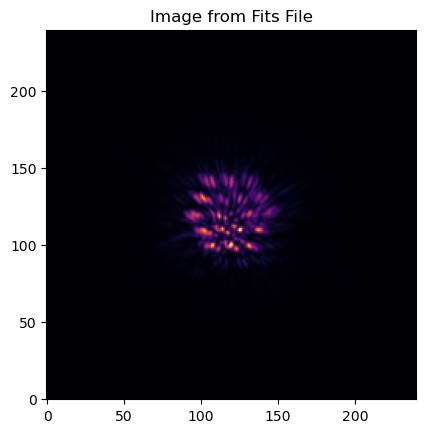

In [3]:
from grater_jax.optimization.optimize_framework import OptimizeUtils

fits_image_filepath = "test_images/" + 'jw04050015001_03106_00001_nrca2_calints' + ".fits"
hdul = fits.open(fits_image_filepath)

#Displays File Info
hdul.info()

# Gets Image
target_image = OptimizeUtils.process_image(hdul['SCI'].data[0], bounds=(120, 360, 120, 360))

# Displays Image
plt.imshow(target_image, origin='lower', cmap='inferno')
plt.title("Image from Fits File")

### Importing Necessary Modules

In [5]:
from grater_jax.optimization.optimize_framework import Optimizer, OptimizeUtils
from grater_jax.disk_model.objective_functions import objective_model, objective_ll, objective_fit, Parameter_Index
from grater_jax.disk_model.SLD_ojax import ScatteredLightDisk
from grater_jax.disk_model.SLD_utils import *

### Obtaining target image and Generating error map

In [6]:

target_image = OptimizeUtils.process_image(hdul['SCI'].data[0], bounds=(120, 360, 120, 360))
err_map = OptimizeUtils.process_image(OptimizeUtils.create_empirical_err_map(hdul['ERR'].data[0]), bounds=(40, 280, 40, 280)) #, outlier_pixels=[(57, 68)]))

In [7]:
folder = "stellar_psf_images/"
fits_files = [f for f in os.listdir(folder) if f.endswith(".fits")]
image_list = []
for fname in fits_files:
    path = os.path.join(folder, fname)
    with fits.open(path) as hdul_stellar:
        sci_data = hdul_stellar['SCI'].data[0]  # shape (H, W)
        image_list.append(OptimizeUtils.process_image(sci_data, bounds=(120, 360, 120, 360)))
image_stack_np = np.stack(image_list)  # shape (N, H, W)
image_stack_jax = jnp.array(image_stack_np)  # shape (N, H, W)

### Defining stellar psf reference images

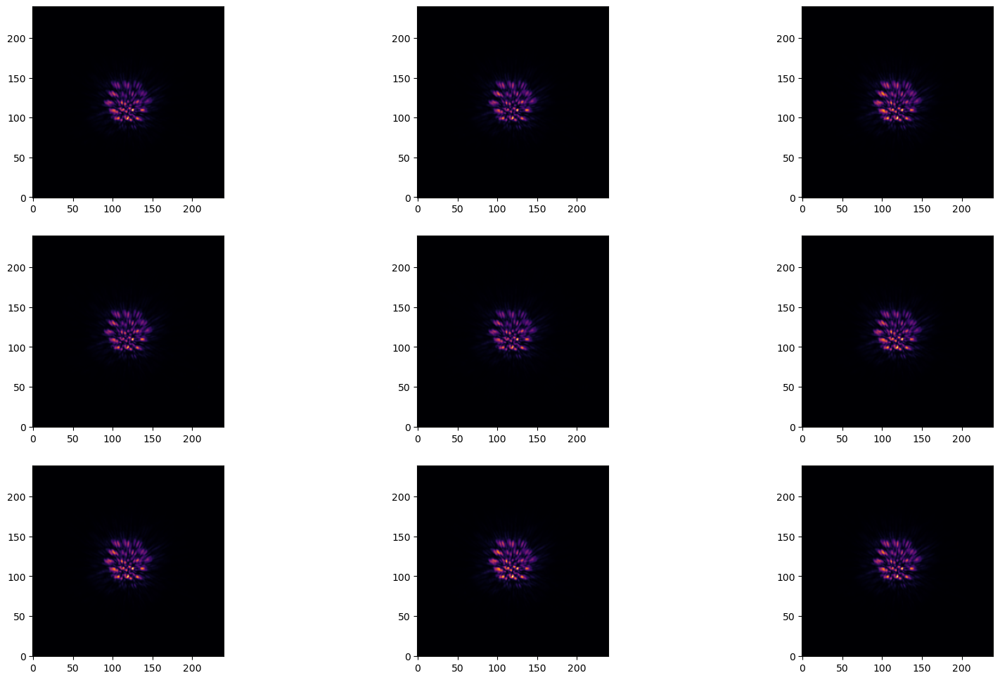

In [8]:
fig, axes = plt.subplots(len(image_stack_jax)//3, 3, figsize=(20, 12))
for i in range(0, len(image_stack_jax)):
    axes[i//3][i%3].imshow(image_stack_jax[i], origin='lower', cmap='inferno')

## Creating WinniePSF NIRCam Object

In [10]:
from grater_jax.disk_model.winnie_jwst_fm import generate_nircam_psf_grid
from grater_jax.disk_model.SLD_utils import Winnie_PSF
import numpy as np
import webbpsf_ext

# 1. Star center in aligned image (shifted to nominal coronagraph center)
cent = np.array([120, 120])

# 2. No offset between star and coronagraph center for each roll
dc_rolls = np.array([[0, 0], [0, 0]])
c_coron_rolls = cent + dc_rolls  # Final per-roll star positions (pixels)

# 3. PSF grid settings
fov_pix = 153            # Field of view in detector pixels
osamp = 2                # PSF oversampling factor
source_spectrum = None   # Flat spectrum (default stellar)

# 4. Define the NIRCam instrument
inst = webbpsf_ext.NIRCam_ext(
    fov_pix=fov_pix,
    oversample=osamp,
    filter='F200W',
    pupil_mask='MASK210R',
    module='A',
    channel='SHORT',
    detector='NRCA2'
)

# 5. Set optical path differences and pupil misalignments
inst.options['pupil_shift_x'] = -0.012
inst.options['pupil_shift_y'] = -0.008
inst.options['defocus_waves'] = -0.00865
inst.options['pupil_rotation'] = -0.595

# 6. Precompute interpolation coefficients for faster PSF generation
inst.gen_psf_coeff()
inst.gen_wfemask_coeff(large_grid=True)

# 7. Generate PSF grid
print("Generating PSFs...")
psfs, psf_inds_rolls, im_mask_rolls, psf_offsets = generate_nircam_psf_grid(
    inst,
    c_coron_rolls,
    source_spectrum=source_spectrum,
    normalize=True,
    log_rscale=True,
    nr=5,
    rmax=10**0.5,
    ntheta=4,
    use_coeff=True
)

test_parangs = [0.]
n_unique_inds = len(jnp.unique(psf_inds_rolls))

psf_params_F200M = Winnie_PSF.init(psfs, psf_inds_rolls, im_mask_rolls, psf_offsets, test_parangs, n_unique_inds)


Generating PSFs...


PSFs:   0%|          | 0/21 [00:00<?, ?it/s]

### Initializing Disk Model Parameters

In [11]:
start_disk_params = Parameter_Index.disk_params.copy()
start_spf_params = InterpolatedUnivariateSpline_SPF.params.copy()
start_psf_params = psf_params_F200M
start_stellar_psf_params = PositionalStellarPSF.params.copy()
start_misc_params = Parameter_Index.misc_params.copy()

start_disk_params['sma'] = 70.12
start_disk_params['inclination'] = 72.40
start_disk_params['position_angle'] = 133.22
start_disk_params['alpha_in'] = 11.99
start_disk_params['alpha_out'] = -4.25
start_disk_params['gamma'] = 1.11

start_spf_params['num_knots'] = 7 # int(row["Knots"])
start_spf_params['knot_values'] = 1e-8 * OptimizeUtils.convert_dhg_params_to_spline_params(0.83, -0.73, 0.94, start_spf_params)

start_stellar_psf_params['stellar_weights'] = 0.004*jnp.ones(len(image_stack_jax))
start_stellar_psf_params['stellar_xs'] = 120*jnp.ones(len(image_stack_jax))
start_stellar_psf_params['stellar_ys'] = 120*jnp.ones(len(image_stack_jax))

start_misc_params['nx'] = 240
start_misc_params['ny'] = 240
start_misc_params['distance'] = 80.2066
start_misc_params['pxInArcsec'] = 0.032

start_disk_params['x_center'] = start_misc_params['nx']/2
start_disk_params['y_center'] = start_misc_params['ny']/2

opt = Optimizer(ScatteredLightDisk, DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, Winnie_PSF,
                start_disk_params, start_spf_params, start_psf_params, start_misc_params, StellarPSFModel=PositionalStellarPSF,
                stellar_psf_params=start_stellar_psf_params)

opt.define_reference_images(image_stack_jax)
opt.inc_bound_knots() # call this method only if you have a good predifined inclination, otherwise don't use it
opt.initialize_knots(target_image-opt.compute_stellar_psf_image())

opt.initialize_stellar_psf_weights(target_image) # <-- Necessary step in order to get good initial stellar psf weight estimates (can manually do this as well)

#### Jit Compiling Model and Gradient Functions

In [12]:
opt.jit_compile_model() # <-- opt.log_likelihood is also jit compiled by this
opt.jit_compile_gradient(target_image, err_map)

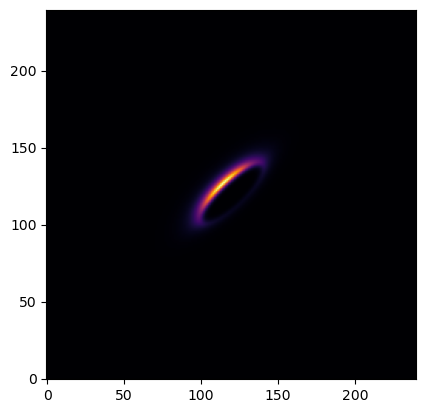

In [13]:
plt.imshow(opt.get_disk(), cmap='inferno', origin='lower') # <-- Just disk model (without off axis and on axis psfs)

## Fitting Disk Model for the Target Image

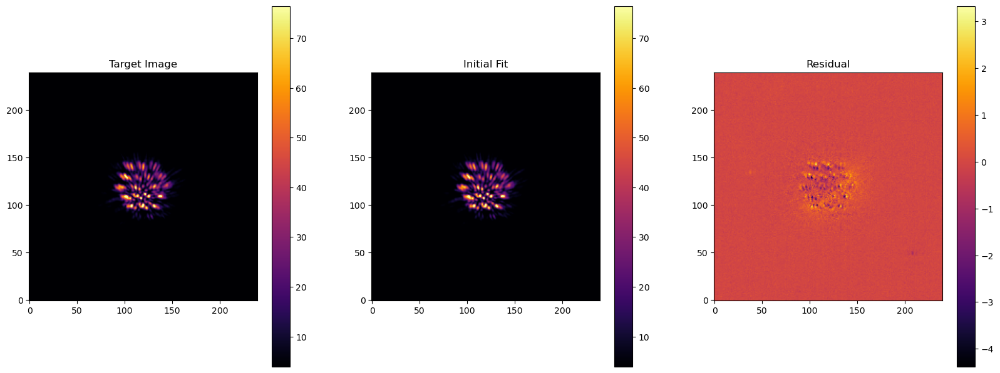

In [14]:
fig, axes = plt.subplots(1,3, figsize=(20,10))
init_image = opt.get_model()

mask = OptimizeUtils.get_mask(target_image)
vmin = np.nanpercentile(target_image[mask], 1)
vmax = np.nanpercentile(target_image[mask], 99)

im = axes[0].imshow(target_image, origin='lower', cmap='inferno')
axes[0].set_title("Target Image")
plt.colorbar(im, ax=axes[0], shrink=0.75)
im.set_clim(vmin, vmax)

im = axes[1].imshow(init_image, origin='lower', cmap='inferno')
axes[1].set_title("Initial Fit")
plt.colorbar(im, ax=axes[1], shrink=0.75)
im.set_clim(vmin, vmax)

im = axes[2].imshow(target_image-init_image, origin='lower', cmap='inferno')
axes[2].set_title("Residual")
plt.colorbar(im, ax=axes[2], shrink=0.75)
# im.set_clim(vmin, vmax)

In [15]:
opt.print_params()

Disk Params: {'accuracy': 0.005, 'alpha_in': 11.99, 'alpha_out': -4.25, 'sma': 70.12, 'e': 0.0, 'ksi0': 3.0, 'gamma': 1.11, 'beta': 1.0, 'rmin': 0.0, 'dens_at_r0': 1.0, 'inclination': 72.4, 'position_angle': 133.22, 'x_center': 120.0, 'y_center': 120.0, 'halfNbSlices': 25, 'omega': 0.0}
SPF Params: {'backscatt_bound': Array(-0.95319067, dtype=float64, weak_type=True), 'forwardscatt_bound': Array(0.95319067, dtype=float64, weak_type=True), 'num_knots': 7, 'knot_values': Array([8.64268514, 2.90095009, 1.55257508, 1.        , 0.71196398,
       0.53980746, 0.42735314], dtype=float64)}
PSF Params: <grater_jax.disk_model.winnie_class.WinniePSF object at 0x7fa3f0376c10>
Stellar PSF Params: {'stellar_weights': array([-2.8942404e-03, -1.2769293e-03,  3.4055905e-03,  9.9285717e-05,
       -9.0930314e-04,  1.6361177e-03,  1.8586181e-02,  8.2717324e-04,
        4.5218747e-03], dtype=float32), 'stellar_xs': Array([120., 120., 120., 120., 120., 120., 120., 120., 120.], dtype=float64), 'stellar_ys':

In [16]:
print(opt._get_raw_gradient(target_image, err_map)) # <-- demonstrates raw gradient output

(Array([-19980.4929142 ,   -987.92820553,  26836.43973602,   1217.75076655,
        92838.51588009,  42620.7472783 , -44227.47006375,  26694.94876916,
            0.        , 119919.08951712,   3702.45548638,   -430.44375083,
        11710.70403315, -13541.98545437,      0.        ,      0.        ],      dtype=float64), Array([-4935.68858732, 13313.58739363, 18903.71357588, 29542.11974516,
       18687.35831691, 67315.61379436, 36084.65056183], dtype=float64), Array([[   -0.      ,    -0.      ,    -0.      , ..., -1522.4349  ,
          968.89606 ,  1181.5336  ],
       [   -0.      ,     0.      ,    -0.      , ...,  2209.86    ,
         3402.3254  ,  4419.3076  ],
       [    0.      ,    -0.      ,     0.      , ..., -2475.6865  ,
         1525.8789  , -1213.2253  ],
       ...,
       [ 3052.0679  ,   537.2665  ,  -435.12085 , ...,   430.57645 ,
         -605.4521  ,  -325.32025 ],
       [-6026.1196  ,  2004.4668  ,  4401.2227  , ...,   219.3026  ,
          325.14252 ,   288.5

In [17]:
# Number of stellar psf images
num_refs = len(image_stack_jax)

# Logscaling helps when you want to fit parameters across orders of magnitude

fit_keys = ['alpha_in', 'alpha_out', 'sma', 'inclination', 'position_angle', 'x_center', 'y_center', 'knot_values',
            'stellar_weights', 'stellar_xs', 'stellar_ys', 'e']
logscaled_params = ['knot_values', 'stellar_weights']
array_params = ['knot_values', 'stellar_weights', 'stellar_xs', 'stellar_ys']

bounds = ([0.1, -15, 0, 0, 0, 110, 110, np.zeros(7), np.zeros(num_refs), 110*np.ones(num_refs), 110*np.ones(num_refs), 0],
          [20, -0.1, 150, 180, 400, 130, 130, 1e4*np.ones(7), np.ones(num_refs), 130*np.ones(num_refs), 130*np.ones(num_refs), 1])

opt.scipy_bounded_optimize(fit_keys, bounds, logscaled_params, array_params, target_image, err_map, use_grad = False,
                            disp_soln = True, iters = 2000, eps = 1e-40, gtol=1e-40)
optimal_image = opt.get_model()

  message: ABNORMAL: 
  success: False
   status: 2
      fun: 590989832.726163
        x: [ 1.209e+01 -4.380e+00 ...  1.201e+02  0.000e+00]
      nit: 1
      jac: [ 8.989e+04 -1.078e+06 ...  1.739e+08 -1.192e+33]
     nfev: 1935
     njev: 45
 hess_inv: <42x42 LbfgsInvHessProduct with dtype=float64>


### Results

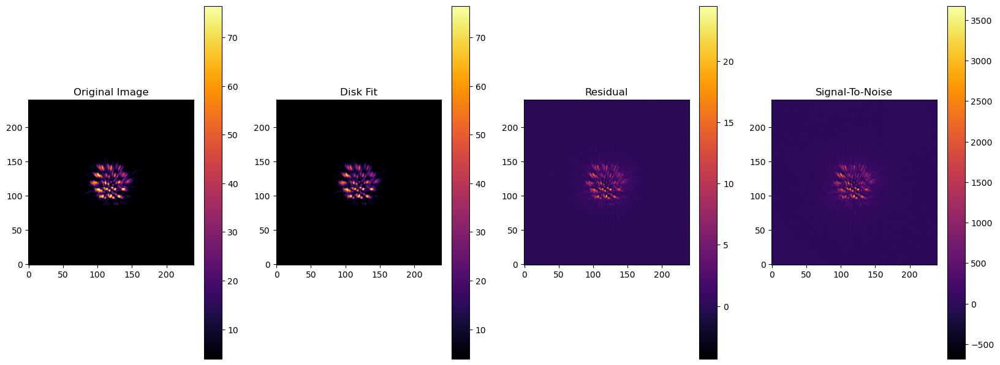

In [18]:
fig, axes = plt.subplots(1,4, figsize=(20,10))

mask = OptimizeUtils.get_mask(target_image)
vmin = np.nanpercentile(target_image[mask], 1)
vmax = np.nanpercentile(target_image[mask], 99)

im = axes[0].imshow(target_image, origin='lower', cmap='inferno')
axes[0].set_title("Original Image")
plt.colorbar(im, ax=axes[0], shrink=0.75)
im.set_clim(vmin, vmax)

im = axes[1].imshow(optimal_image, origin='lower', cmap='inferno')
axes[1].set_title("Disk Fit")
plt.colorbar(im, ax=axes[1], shrink=0.75)
im.set_clim(vmin, vmax)

im = axes[2].imshow(target_image-optimal_image, origin='lower', cmap='inferno')
axes[2].set_title("Residual")
plt.colorbar(im, ax=axes[2], shrink=0.75)
# im.set_clim(vmin, vmax)

im = axes[3].imshow(np.where(err_map == 0., 0., (target_image-optimal_image) / err_map), origin='lower', cmap='inferno')
axes[3].set_title("Signal-To-Noise")
plt.colorbar(im, ax=axes[3], shrink=0.75)
# im.set_clim(vmin, vmax)

In [19]:
#opt.scale_spline_to_fixed_point(0, 1)
opt.print_params()
opt.log_likelihood(target_image, err_map)

Disk Params: {'accuracy': 0.005, 'alpha_in': np.float64(12.086961863959866), 'alpha_out': np.float64(-4.380129842393079), 'sma': np.float64(71.08695551724271), 'e': np.float64(0.0), 'ksi0': 3.0, 'gamma': 1.11, 'beta': 1.0, 'rmin': 0.0, 'dens_at_r0': 1.0, 'inclination': np.float64(71.52359064285965), 'position_angle': np.float64(131.60735836245527), 'x_center': np.float64(119.8789489838204), 'y_center': np.float64(120.1210510161796), 'halfNbSlices': 25, 'omega': 0.0}
SPF Params: {'backscatt_bound': Array(-0.95319067, dtype=float64, weak_type=True), 'forwardscatt_bound': Array(0.95319067, dtype=float64, weak_type=True), 'num_knots': 7, 'knot_values': array([5.69952997, 1.93851755, 1.04536626, 1.        , 0.48391893,
       0.36813638, 0.2922704 ])}
PSF Params: <grater_jax.disk_model.winnie_class.WinniePSF object at 0x7fa3f0376c10>
Stellar PSF Params: {'stellar_weights': array([1.00000051e-14, 1.00000050e-14, 2.46941521e-03, 7.51403579e-05,
       1.00000051e-14, 1.19693391e-03, 1.3202930

Array(-5.90989833e+08, dtype=float64)

### Final Disk Results

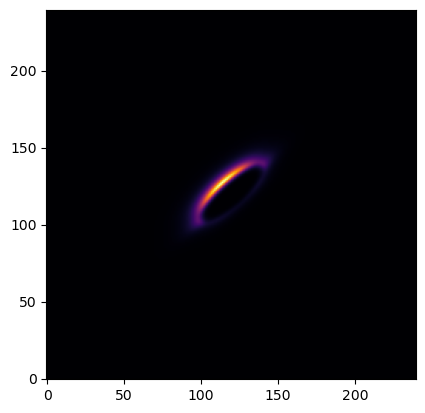

In [20]:
plt.imshow(opt.get_disk(), cmap='inferno', origin='lower')

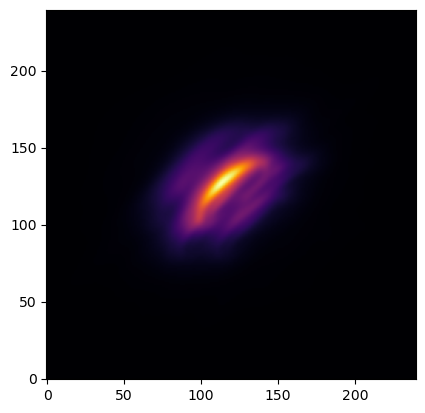

In [21]:
plt.imshow(opt.get_model()-opt.compute_stellar_psf_image(), cmap='inferno', origin='lower')

## Running MCMC

In [22]:
# Running optimization method
fit_keys = ['alpha_in', 'alpha_out', 'sma', 'inclination', 'position_angle', 'x_center', 'y_center', 'knot_values', 'stellar_weights',
            'stellar_xs', 'stellar_ys', 'e']
logscaled_params = ['knot_values', 'stellar_weights']
array_params = ['knot_values', 'stellar_weights', 'stellar_xs', 'stellar_ys']
bounds = ([0.1, -15, 0, 0, 0, 110, 110, np.zeros(7), np.zeros(num_refs), 110*np.ones(num_refs), 110*np.ones(num_refs), 0],
          [200, -0.1, 150, 180, 400, 130, 130, 1e4*np.ones(7), np.ones(num_refs), 130*np.ones(num_refs), 130*np.ones(num_refs), 1])

mc_model = opt.mcmc(fit_keys, logscaled_params, array_params, target_image, err_map, bounds, nwalkers=100, niter=100, burns=20,
                    scale_objective_function_for_shape = True)

Running burn-in...


100%|██████████| 20/20 [00:29<00:00,  1.46s/it]


Running production...


100%|██████████| 100/100 [03:19<00:00,  2.00s/it]


In [23]:
mc_soln = np.median(mc_model.sampler.flatchain, axis=0)
img = opt.get_model()

### Results

Text(0.5, 1.0, 'Post MCMC')

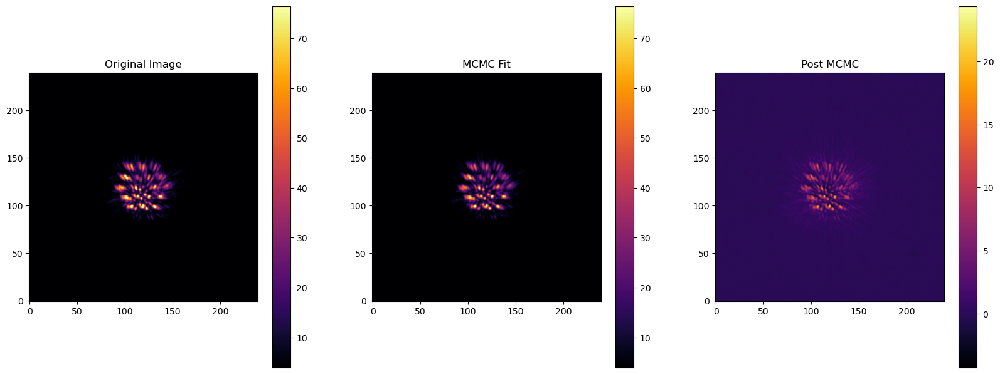

In [24]:
fig, axes = plt.subplots(1,3, figsize=(20,10))

mask = OptimizeUtils.get_mask(target_image)
vmin = np.nanpercentile(target_image[mask], 1)
vmax = np.nanpercentile(target_image[mask], 99)

im = axes[0].imshow(target_image, origin='lower', cmap='inferno')
axes[0].set_title("Original Image")
plt.colorbar(im, ax=axes[0], shrink=0.75)
im.set_clim(vmin, vmax)

im = axes[1].imshow(img, origin='lower', cmap='inferno')
axes[1].set_title("MCMC Fit")
plt.colorbar(im, ax=axes[1], shrink=0.75)
im.set_clim(vmin, vmax)

im = axes[2].imshow(target_image-img, origin='lower', cmap='inferno')
axes[2].set_title("Residual")
plt.colorbar(im, ax=axes[2], shrink=0.75)
# im.set_clim(vmin, vmax)
plt.title("Post MCMC")

### Plotting MCMC Results

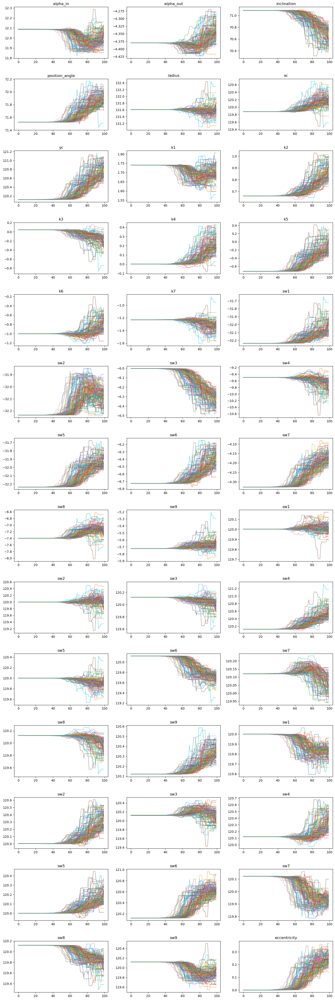

In [25]:
labels = ['alpha_in', 'alpha_out', 'inclination', 'position_angle', 'radius', 'xc', 'yc']
for i in range(0, opt.spf_params['num_knots']):
    labels.append('k'+str(i+1))
for i in range(0, len(opt.stellar_psf_params['stellar_weights'])):
    labels.append('sw'+str(i+1))
for i in range(0, len(opt.stellar_psf_params['stellar_xs'])):
    labels.append('sw'+str(i+1))
for i in range(0, len(opt.stellar_psf_params['stellar_ys'])):
    labels.append('sw'+str(i+1))
labels.append('eccentricity')
mc_model.plot_chains(labels)

### Corner Plot

In [26]:
mc_model.show_corner_plot(labels, truths=mc_soln, quiet = True)

In [27]:
print(dict(zip(labels, mc_model.get_theta_median())))

{'alpha_in': np.float64(12.086299655333232), 'alpha_out': np.float64(-4.380130640037345), 'inclination': np.float64(71.08575965907069), 'position_angle': np.float64(71.52530291837823), 'radius': np.float64(131.60735921670272), 'xc': np.float64(119.87945668397724), 'yc': np.float64(120.12389215764753), 'k1': np.float64(1.7400020995637415), 'k2': np.float64(0.662368449700387), 'k3': np.float64(0.04315362765956155), 'k4': np.float64(8.605684220477369e-05), 'k5': np.float64(-0.722621224344584), 'k6': np.float64(-0.9993024092145478), 'k7': np.float64(-1.230076865338352), 'sw1': np.float64(119.99837281256812), 'sw2': np.float64(120.00086778465351), 'sw3': np.float64(120.12113930950449), 'sw4': np.float64(120.12105123341225), 'sw5': np.float64(120.00068838122705), 'sw6': np.float64(120.12388145691082), 'sw7': np.float64(120.1195592400197), 'sw8': np.float64(120.11840322291721), 'sw9': np.float64(120.11924562692631), 'eccentricity': np.float64(0.0012586613003035076)}
